In [113]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy import stats
import warnings
warnings.filterwarnings('ignore')

In [114]:
data = pd.read_excel('AirQualityUCI.xlsx')
data.replace(-200, np.nan, inplace=True)
data.dropna(subset=['C6H6(GT)', 'Date', 'Time'] ,axis=0, inplace=True)

In [115]:
data.set_index(['Date', 'Time'], inplace=True)

In [116]:
from pandas_profiling import ProfileReport
report = ProfileReport(data, title='AirQuality')

In [117]:
report.to_notebook_iframe()

## TODO

- Impute missing values in the dataset
- NMHC(GT) has more than 90% missing values, drop it
- Check correlation with target in the data



In [118]:
TARGET = 'C6H6(GT)'
SEED = 13

In [119]:
y = data[TARGET]
X = data.drop([TARGET,'NMHC(GT)'] , axis=1)

In [120]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False, random_state=SEED)
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, shuffle=False, random_state=SEED)


## Preprocessing

- Imputing missing values in the data
- Normalizing numerical features

In [121]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler


imp = SimpleImputer(strategy='median')
sc = StandardScaler()

c, i = X_train.columns, X_train.index
X_train = imp.fit_transform(X_train)
X_train = pd.DataFrame(sc.fit_transform(X_train))
X_train.columns, X_train.index = c, i

i = X_valid.index
X_valid = imp.transform(X_valid)
X_valid = pd.DataFrame(sc.transform(X_valid))
X_valid.columns, X_valid.index = c, i

i = X_test.index
X_test = imp.transform(X_test)
X_test = pd.DataFrame(sc.transform(X_test))
X_test.columns, X_test.index = c, i

In [122]:
X_valid.tail()

CO(GT)  PT08.S1(CO)  PT08.S2(NMHC)   NOx(GT)  \
Date       Time                                                       
2004-12-26 00:00:00  0.625748     0.899176      -0.253865  2.078289   
           01:00:00 -0.278653     0.363765      -0.558026  0.925672   
           02:00:00 -0.549973    -0.159533      -1.079303  0.268478   
           03:00:00 -1.183053    -0.824557      -1.635598 -0.216835   
           04:00:00 -1.273493    -0.902083      -1.710638 -0.793143   

                     PT08.S3(NOx)   NO2(GT)  PT08.S4(NO2)  PT08.S5(O3)  \
Date       Time                                                          
2004-12-26 00:00:00     -0.815903  0.778718     -1.110046     0.417212   
           01:00:00     -0.442621  0.658377     -1.263729    -0.024010   
           02:00:00      0.055447  0.387610     -1.699165    -0.457379   
           03:00:00      1.141946 -0.033583     -2.085270    -1.229161   
           04:00:00      1.567939 -1.206907     -2.065348    -1.416931   

                            T        RH        AH  
Date       Time                                    
2004-12-26 00:00:00 -1.560251  2.237342 -0.265946  
           01:00:00 -1.573726  2.251407 -0.277515  
           02:00:00 -1.610782  2.256096 -0.330398  
           03:00:00 -1.563620  1.882574 -0.496173  
           04:00:00 -1.681525  2.170139 -0.486101

In [123]:
def adj_r2(y, pr, x):
    n, p = x.shape
    return 1-(1-r2(y, pr))*(n-1)/(n-p-1)

<AxesSubplot:>

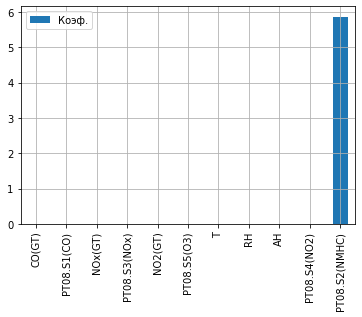

In [124]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet

from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import r2_score as r2

model = Lasso()
model.fit(X_train, y_train)

coef = pd.DataFrame(model.coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

## Non-linear transformations


- Add quadratic and cubic features for PT08.S2 (chosen via L1 regularization model)

In [125]:
X_train['S2^2'] = X_train['PT08.S2(NMHC)'] ** 2
X_valid['S2^2'] = X_valid['PT08.S2(NMHC)'] ** 2
X_test['S2^2'] = X_test['PT08.S2(NMHC)'] ** 2
X_train['S2^3'] = X_train['PT08.S2(NMHC)'] ** 3
X_valid['S2^3'] = X_valid['PT08.S2(NMHC)'] ** 3
X_test['S2^3'] = X_test['PT08.S2(NMHC)'] ** 3

## Baseline

Linear regression without regularization

### Linear regression with regularization

Linear regression, sklearn, mae 0.010438892178427289
Linear regression, mse 0.00037635157611879593
Linear regression, r^2 0.9999910655438456
Linear regression, adjusted r^2 0.9999910135528295


<AxesSubplot:>

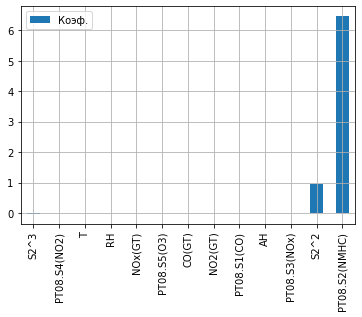

In [126]:
model = LinearRegression()
model.fit(X_train, y_train)
preds = model.predict(X_test)

print('Linear regression, sklearn, mae', mae(y_test, preds))
print('Linear regression, mse', mse(y_test, preds))
print('Linear regression, r^2', r2(y_test, preds))
print('Linear regression, adjusted r^2', adj_r2(y_test, preds, X_test))

coef = pd.DataFrame(model.coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

### Linear regression w/ regularization,  Cross-validation for Elastic Net

L2, sklearn, mae 0.013282383007646923
L2, mse 0.0008214810840852316
L2, r^2 0.99999021794522
L2, adjusted r^2 0.999990141888574


<AxesSubplot:>

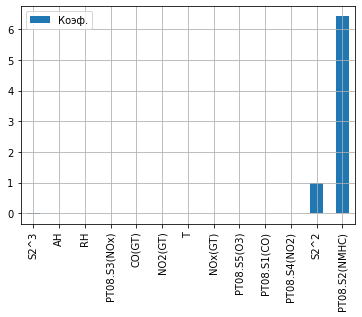

In [127]:
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV

model = Ridge()
model.fit(X_train, y_train)
preds = model.predict(X_valid)

print('L2, sklearn, mae', mae(y_valid, preds))
print('L2, mse', mse(y_valid, preds))
print('L2, r^2', r2(y_valid, preds))
print('L2, adjusted r^2', adj_r2(y_valid, preds, X_valid))

coef = pd.DataFrame(model.coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)


L2, sklearn, mae 1.811080987294206
L2, mse 10.406018121914034
L2, r^2 0.8760869345847232
L2, adjusted r^2 0.8751234956789824


<AxesSubplot:>

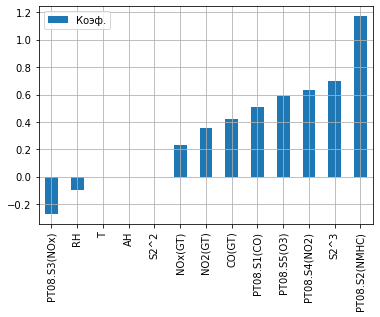

In [128]:
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV

model = ElasticNet()
model.fit(X_train, y_train)
preds = model.predict(X_valid)

print('L2, sklearn, mae', mae(y_valid, preds))
print('L2, mse', mse(y_valid, preds))
print('L2, r^2', r2(y_valid, preds))
print('L2, adjusted r^2', adj_r2(y_valid, preds, X_valid))

coef = pd.DataFrame(model.coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)


In [131]:
cv = TimeSeriesSplit()
params = {
    'alpha': np.arange(0, 5, 0.1),
    'l1_ratio': np.arange(0, 1.1, 0.1)
}
reg = GridSearchCV(model, cv=cv, scoring='r2', param_grid=params)

In [132]:
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=ElasticNet(),
             param_grid={'alpha': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
       1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5,
       2.6, 2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8,
       3.9, 4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9]),
                         'l1_ratio': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])},
             scoring='r2')

In [133]:
reg.best_params_

{'alpha': 0.0, 'l1_ratio': 0.0}

Linear regression, sklearn, mae 0.010961285537999004
Linear regression, mse 0.00042349535204351426
Linear regression, r^2 0.9999899463669226
Linear regression, adjusted r^2 0.9999898878632386


<AxesSubplot:>

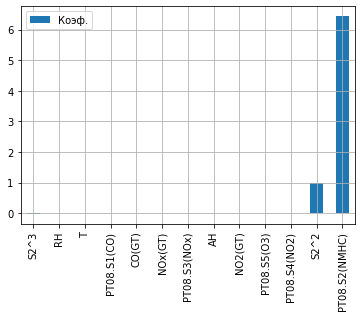

In [137]:
model = ElasticNet(alpha = 0.0, l1_ratio=0.0)
model.fit(X_train, y_train)
preds = model.predict(X_test)

print('Linear regression, sklearn, mae', mae(y_test, preds))
print('Linear regression, mse', mse(y_test, preds))
print('Linear regression, r^2', r2(y_test, preds))
print('Linear regression, adjusted r^2', adj_r2(y_test, preds, X_test))

coef = pd.DataFrame(model.coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

## Non-classic regressions
- SGD regression
- Kernel regression
- SVM regression

In [145]:
from sklearn.linear_model import SGDRegressor

model = SGDRegressor()
params = {
    'penalty': ['elasticnet'],
    'alpha': 1/np.arange(5000, 15000, 2500),
    'l1_ratio': np.arange(0, 1.1, 0.1),
    'max_iter': range(1000, 10000, 500)
}
reg = GridSearchCV(model, cv=cv, scoring='r2', param_grid=params)
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=SGDRegressor(),
             param_grid={'alpha': array([2.00000000e-04, 1.33333333e-04, 1.00000000e-04, 8.00000000e-05]),
                         'l1_ratio': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
                         'max_iter': range(1000, 10000, 500),
                         'penalty': ['elasticnet']},
             scoring='r2')

In [146]:
reg.best_params_

{'alpha': 0.0002, 'l1_ratio': 0.1, 'max_iter': 3500, 'penalty': 'elasticnet'}

In [164]:
model = SGDRegressor(alpha=0.0002, l1_ratio=0.1, max_iter=3500, penalty='elasticnet')
model.fit(X_train, y_train)
preds = model.predict(X_test)

print('SGD, mae', mae(y_test, preds))
print('SGD regression, mse', mse(y_test, preds))
print('SGD regression, r^2', r2(y_test, preds))
print('SGD regression, adjusted r^2', adj_r2(y_test, preds, X_test))

SGD, mae 0.12538771464539689
SGD regression, mse 0.02428140013072687
SGD regression, r^2 0.9994235679651695
SGD regression, adjusted r^2 0.9994202136158173


In [147]:
from sklearn.kernel_ridge import KernelRidge

model = KernelRidge()
params = {
    'alpha': 1/np.arange(0.01, 20, 0.5),
    'degree': [2, 3, 4],
    'coef0':[1, 2, 3]
}
reg = GridSearchCV(model, cv=cv, scoring='r2', param_grid=params)
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=KernelRidge(),
             param_grid={'alpha': array([1.00000000e+02, 1.96078431e+00, 9.90099010e-01, 6.62251656e-01,
       4.97512438e-01, 3.98406375e-01, 3.32225914e-01, 2.84900285e-01,
       2.49376559e-01, 2.21729490e-01, 1.99600798e-01, 1.81488203e-01,
       1.66389351e-01, 1.53609831e-01, 1.42653352e-01, 1.33155792...
       1.24843945e-01, 1.17508813e-01, 1.10987791e-01, 1.05152471e-01,
       9.99000999e-02, 9.51474786e-02, 9.08265213e-02, 8.68809731e-02,
       8.32639467e-02, 7.99360512e-02, 7.68639508e-02, 7.40192450e-02,
       7.13775874e-02, 6.89179876e-02, 6.66222518e-02, 6.44745326e-02,
       6.24609619e-02, 6.05693519e-02, 5.87889477e-02, 5.71102227e-02,
       5.55247085e-02, 5.40248514e-02, 5.26038927e-02, 5.12557663e-02]),
                         'coef0': [1, 2, 3], 'degree': [2, 3, 4]},
             scoring='r2')

In [148]:
reg.best_params_

{'alpha': 100.0, 'coef0': 1, 'degree': 2}

In [165]:
model = KernelRidge(alpha=100, coef0=1, degree=2)
model.fit(X_train, y_train)
preds = model.predict(X_test)

print('Kernel regression, mae', mae(y_test, preds))
print('Kernel regression, mse', mse(y_test, preds))
print('Kernel regression, r^2', r2(y_test, preds))
print('Kernel regression, adjusted r^2', adj_r2(y_test, preds, X_test))

Kernel regression, mae 8.267347193395045
Kernel regression, mse 110.18908352366431
Kernel regression, r^2 -1.6158507042301498
Kernel regression, adjusted r^2 -1.6310727539861891


In [155]:
from sklearn.svm import SVR

model = SVR()
params = {
    'degree': [2,3,4],
    'tol': np.arange(1e-4, 1e-2, 5e-4),
    'C': np.arange(0.01, 2.1, 0.5)
}
reg = GridSearchCV(model, cv=cv, scoring='r2', param_grid=params)
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=SVR(),
             param_grid={'C': array([0.01, 0.51, 1.01, 1.51, 2.01]),
                         'degree': [2, 3, 4],
                         'tol': array([0.0001, 0.0006, 0.0011, 0.0016, 0.0021, 0.0026, 0.0031, 0.0036,
       0.0041, 0.0046, 0.0051, 0.0056, 0.0061, 0.0066, 0.0071, 0.0076,
       0.0081, 0.0086, 0.0091, 0.0096])},
             scoring='r2')

In [156]:
reg.best_params_

{'C': 2.01, 'degree': 2, 'tol': 0.0076}

In [166]:
model = SVR(C=2, degree=2, tol=0.0076)
model.fit(X_train, y_train)
preds = model.predict(X_test)

print('SVR, mae', mae(y_test, preds))
print('SVR, mse', mse(y_test, preds))
print('SVR, r^2', r2(y_test, preds))
print('SVR, adjusted r^2', adj_r2(y_test, preds, X_test))

SVR, mae 2.1119224792461098
SVR, mse 6.8644614421064505
SVR, r^2 0.8370400612902953
SVR, adjusted r^2 0.8360917715842854


The best model is Linear regression w/o regularization, because the PT08(HMHC) feature has high correlation with target

In [175]:
model = LinearRegression()
model.fit(X_train, y_train)
preds = model.predict(X_test)

print('Linear regression, r^2', r2(y_test, preds))



Linear regression, r^2 0.9999910655438456


## Residual analysis

In [176]:
rss = sum((preds - y_test) ** 2)
print('Остаточная сумма квадратов ', rss)
s2 = rss/(len(X_test) - 2)
print('S^2 ', s2)

Остаточная сумма квадратов  0.8460383431150531
S^2  0.0003766867066407182


<AxesSubplot:xlabel='C6H6(GT)', ylabel='Density'>

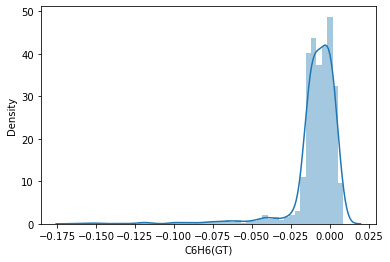

In [169]:
ESS = preds - y_test
sns.distplot(ESS)

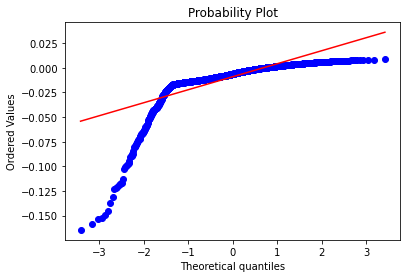

In [172]:
from scipy.stats import probplot
probplot(ESS, plot=plt)
plt.show()

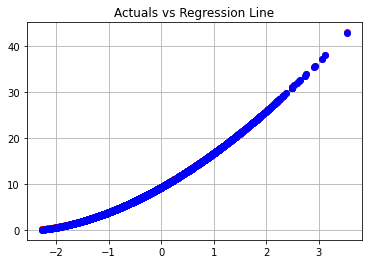

In [177]:
plt.plot(X_test['PT08.S2(NMHC)'], y_test, 'o', color='red');
plt.plot(X_test['PT08.S2(NMHC)'], preds, 'o', color='blue')
plt.title("Actuals vs Regression Line")
plt.grid(True)

In [174]:
from scipy.stats import anderson

if anderson(ESS, dist='norm').critical_values[2] > anderson(ESS, dist='norm').statistic:
    print('Gaussian dist')
else:
    print('Non-gaussian dist')

Non-gaussian dist


Residues' distribution is not the gaussian alike, 'cause the data has feauture that is linear function of target